In [ ]:
!pip install rebound
!pip install astroquery
!pip install tqdm

In [ ]:
import rebound as rb
import numpy as np
import pylab as plt
import pandas as pd

from astroquery.jplhorizons import Horizons
from astropy.time import Time

from tqdm import tqdm

# Efemérides y Vectores de Estado de Horizons


In [ ]:
"TIEMPOS"
t_ini = Time('2020-11-01 00:00:00',format='iso')
t_end = Time('2021-04-01 00:00:00',format='iso')
times = {'start':t_ini.value, 'stop':t_end.value, 'step':'3h'}

deltat = t_end.jd - t_ini.jd
dt = float(times['step'][0]) / 24

In [ ]:
key = ['x','y','z','vx','vy','vz'] #Llaves del diccionario de kwargs de sim.add()

"OBJETOS DE HORIZONS"
obj = Horizons('2020 SO',location='500',id_type='designation',epochs=times)
Luna = Horizons('301',location='500',id_type='majorbody',epochs=times)
MLuna = 0.0123

eph = obj.ephemerides() #Efemérides de 2020 SO

"VECTORES DE ESTADO DE 2020SO Y DE LUNA"
vec = obj.vectors().to_pandas()
V = np.array(vec.iloc[0,5:11],dtype=float)
Vdict = dict(zip(key,V)) #La lista la vuelvo un diccionario para meterla en kwargs

vecLuna = Luna.vectors().to_pandas()
VLuna = np.array(vecLuna.iloc[0,3:9],dtype=float)
VdictLuna = dict(zip(key,VLuna)) #La lista la vuelvo un diccionario para meterla en kwargs

7.958913626767201


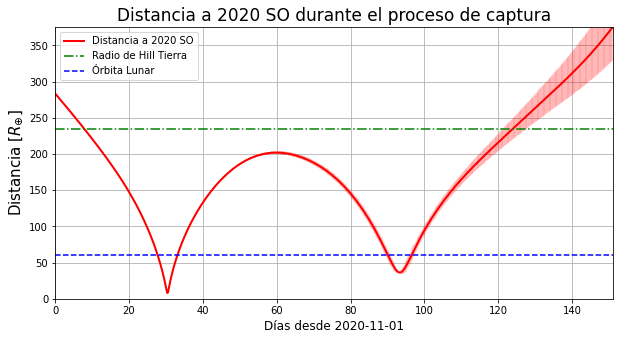

In [ ]:
UL = 1.5e8/6366

Nt = len(vec)

q = 3/24

plt.figure(figsize=(10,5))

plt.plot(np.arange(Nt)*q,eph['delta']*UL,color='r',lw=2,label = "Distancia a 2020 SO")
plt.errorbar(np.arange(Nt)*q,eph['delta']*UL,yerr=eph['r_3sigma']/6366,
             color='r',alpha=0.1)


plt.plot([0,Nt*q],[235,235],'g-.',label="Radio de Hill Tierra")
plt.plot([0,Nt*q],[60,60],'b--',label="Órbita Lunar")

plt.xlim([0,Nt*q])
plt.ylim([0,max(eph['delta']*UL)])

print(min(eph['delta']*UL))

plt.ylabel("Distancia [$R_{\oplus}$]",size=15)
plt.xlabel("Días desde 2020-11-01",size=12)
plt.title("Distancia a 2020 SO durante el proceso de captura",size=17)

plt.legend()
plt.grid()

# Simulación Heliocéntrica restando el Vector Terrestre


In [ ]:
date = t_ini.value[:16]

sim = rb.Simulation()
sim.units = ['AU','mearth','days']
sim.add("Sun",date=date)
sim.add("399",date=date)
sim.add("2020 SO",date=date)
sim.add("301",date=date)

sim.save("SistemaSOL.bin")

Searching NASA Horizons for 'Sun'... Found: Sun (10).
Searching NASA Horizons for '399'... Found: Earth (399).
Searching NASA Horizons for '2020 SO'... Found: (2020 SO).
Searching NASA Horizons for '301'... 

/usr/local/lib/python3.6/dist-packages/rebound/horizons.py:140: RuntimeWarning: Warning: Mass cannot be retrieved from NASA HORIZONS. Set to 0.
  warnings.warn("Warning: Mass cannot be retrieved from NASA HORIZONS. Set to 0.", RuntimeWarning)


Found: Moon (301).


In [ ]:
def V(a): return np.array([a.x,a.y,a.z,a.vx,a.vy,a.vz])

def COM(a,b):
  """
  Dadas las partículas a y b, se calcula el vector de estado de su centro de Masa
  """
  return (a.m*V(a) + b.m*V(b)) / (a.m + b.m)

In [ ]:
sim = rb.Simulation("SistemaSOL.bin")

sim.dt = dt

Nt = int(deltat/sim.dt) + 1 
ts = np.linspace(0,deltat,Nt)

vecR = np.zeros((Nt,6)) #Vector de Estado en Rebound
vecRLuna = np.zeros((Nt,6)) #Vector de Estado de Luna en Rebound
vecREarth = np.zeros((Nt,6)) #Vector de Estado de Tierra en Rebound

for i,t in enumerate(tqdm(ts)):
  sim.integrate(t)
  e = sim.particles[1]
  l = sim.particles[3]
  comVec = COM(e,l)

  p = sim.particles[2]
  vecR[i] = V(p) - V(e)
  vecRLuna[i] = V(l) - V(e)
  vecREarth[i] = V(e)

vecR = pd.DataFrame(vecR,columns=key)
vecRLuna = pd.DataFrame(vecRLuna,columns=key)
vecREarth = pd.DataFrame(vecREarth,columns=key)

100%|██████████| 1209/1209 [00:00<00:00, 13872.47it/s]


In [ ]:
p = sim.particles[2]
pdict = dict(zip(key,np.array(vecR.iloc[-1])+V(e)))

sim0 = rb.Simulation()
sim0.units = ['AU','mearth','days']
sim0.add('Sun')
sim0.add(m=0,**pdict)

p2 = sim0.particles[1]

print(p2.a,p2.e,np.rad2deg(p2.inc))
print(p.a,p.e,np.rad2deg(p.inc))

Searching NASA Horizons for 'Sun'... Found: Sun (10).
0.9645053759229024 0.021310112866965773 0.13708216602075987
0.9621720239004453 0.02244392064222893 0.13849658622347943


(-1.0865715023760467,
 1.035227089405281,
 -1.0608242381155493,
 1.0602146127685406)

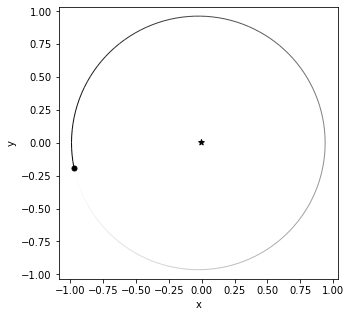

In [ ]:
sim0.calculate_orbits()
rb.OrbitPlot(sim0)
plt.axis("equal")

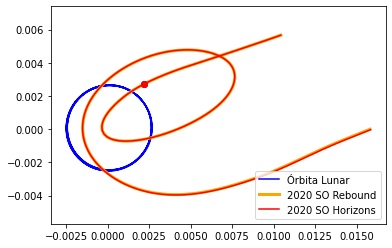

In [ ]:
i = 210

# plt.plot(vecREarth['x'],vecREarth['y'],'g',label="Tierra")
plt.plot(vecRLuna['x'],vecRLuna['y'],'b',label="Órbita Lunar")
plt.plot(vecR['x'],vecR['y'],label="2020 SO Rebound",color='orange',lw=3)
plt.plot(vecR['x'][i],vecR['y'][i],'ko')

plt.plot(vec['x'],vec['y'],'r',label="2020 SO Horizons")
plt.plot(vec['x'][i],vec['y'][i],'ro')
plt.legend()
plt.axis("equal")
plt.show()

# Órbita sin la Luna

In [ ]:
date = t_ini.value[:16]

sim2 = rb.Simulation()
sim2.units = ['AU','mearth','days']
sim2.add("Sun",date=date)
sim2.add("399",date=date)
sim2.add("2020 SO",date=date)

sim2.save("SistemaSOL2.bin")

Searching NASA Horizons for 'Sun'... Found: Sun (10).
Searching NASA Horizons for '399'... Found: Earth (399).
Searching NASA Horizons for '2020 SO'... Found: (2020 SO).


/usr/local/lib/python3.6/dist-packages/rebound/horizons.py:140: RuntimeWarning: Warning: Mass cannot be retrieved from NASA HORIZONS. Set to 0.
  warnings.warn("Warning: Mass cannot be retrieved from NASA HORIZONS. Set to 0.", RuntimeWarning)


In [ ]:
sim = rb.Simulation("SistemaSOL.bin")
sim2 = rb.Simulation("SistemaSOL2.bin")
sim2.dt = dt

Nt = int(deltat/sim2.dt) + 1
ts = np.linspace(0,deltat,Nt)

vecR2 = np.zeros((Nt,6)) #Vector de Estado en Rebound sin Luna

for i,t in enumerate(tqdm(ts)):
  SIM = sim2
  SIM.integrate(t)
  e = SIM.particles[1]
  p = SIM.particles[2]
  vecR2[i] = V(p) - V(e) #np.array(vecREarth.iloc[i])

vecR2 = pd.DataFrame(vecR2,columns=key)

100%|██████████| 1209/1209 [00:00<00:00, 21634.97it/s]


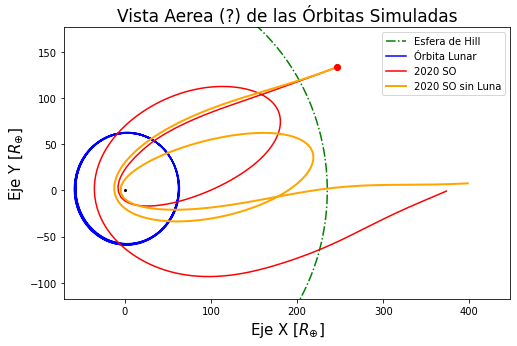

In [ ]:
UL = 1.5e8/6366
i = 0

k = 110
ths = np.deg2rad(np.linspace(-k,k,100))
xs = [235 * np.cos(th) for th in ths]
ys = [235 * np.sin(th) for th in ths]

plt.figure(figsize=(8,5))

plt.plot(xs,ys,'g-.',label="Esfera de Hill")
plt.plot(vecRLuna['x']*UL,vecRLuna['y']*UL,'b',label="Órbita Lunar")
plt.plot(vec['x']*UL,vec['y']*UL,'r',label="2020 SO")
plt.plot(vecR2['x']*UL,vecR2['y']*UL,label="2020 SO sin Luna",color='orange',lw=2)

plt.plot(vecR2['x'][i]*UL,vecR2['y'][i]*UL,color='orange',marker='o')
plt.plot(vec['x'][i]*UL,vec['y'][i]*UL,'ro')
plt.plot(0,0,'ko',ms=2)

plt.title("Vista Aerea (?) de las Órbitas Simuladas",size=17)
plt.xlabel("Eje X [$R_{\oplus}$]",size=15)
plt.ylabel("Eje Y [$R_{\oplus}$]",size=15)


plt.xlim([-0.003*UL,0.019*UL])
plt.ylim([-0.005*UL,0.0075*UL])
# plt.axis("equal")
plt.legend()
plt.show()

In [ ]:
def RyV(lis):
  """
  Función que genera una columna 'r' y una 'v' para los DataFrames
  """
  lis['r'] = (lis['x']**2 + lis['y']**2 + lis['z']**2)**.5
  lis['v'] = (lis['vx']**2 + lis['vy']**2 + lis['vz']**2)**.5

RyV(vec)
RyV(vecR)
RyV(vecR2)

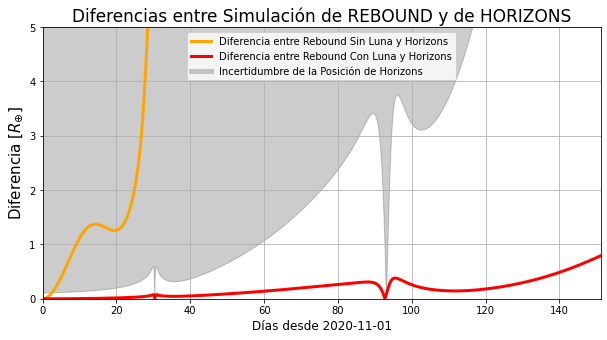

In [ ]:
UL = 1.5e8/6366

s = 'r'
q = 3/24
a = 0.2

fig,ax = plt.subplots(figsize=(10,5))

plt.plot(np.arange(Nt)[:int(30/q)]*q,abs(vecR2[s]-vec[s])[:int(30/q)]*UL,'ORANGE',lw=3,label="Diferencia entre Rebound Sin Luna y Horizons")
plt.plot(np.arange(Nt)*q,abs(vecR[s]-vec[s])*UL,'r',lw=3,label="Diferencia entre Rebound Con Luna y Horizons")
plt.plot(-10,0,lw=5,color='k',alpha=a,label="Incertidumbre de la Posición de Horizons")

ax.fill_between(np.arange(Nt)*q,eph['r_3sigma']/6366/2,100,alpha=a,color='k')
ax.fill_between(np.arange(Nt)*q,-eph['r_3sigma']/6366/2,-100,alpha=a,color='k')



plt.title("Diferencias entre Simulación de REBOUND y de HORIZONS",size=17)
plt.ylabel("Diferencia [$R_{\oplus}$]",size=15)
plt.xlabel("Días desde 2020-11-01",size=12)

ymax = 5
plt.xlim([0,Nt*q])
plt.ylim([0,ymax])

plt.legend(loc=9)
plt.grid()

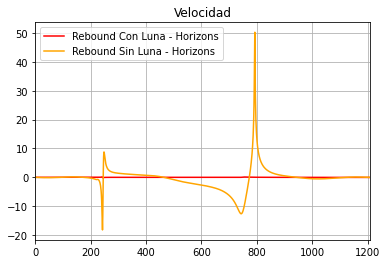

In [ ]:
UL = 1.5e8/6366

s = 'v'

plt.title("Velocidad")
plt.plot((vecR[s]-vec[s])*UL,'r',label="Rebound Con Luna - Horizons")
plt.plot((vecR2[s]-vec[s])*UL,'orange',label="Rebound Sin Luna - Horizons")

# plt.ylim([-2e-5*UL,2e-5*UL])
plt.xlim([0,Nt])
plt.legend()
plt.grid()

5.573794942229676


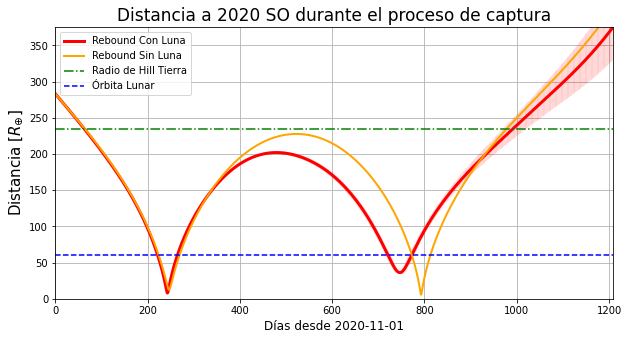

In [ ]:
UL = 1.5e8/6366
q = 1
s = 'r'

plt.figure(figsize=(10,5))

plt.errorbar(np.arange(Nt)*q,eph['delta']*UL,yerr=eph['r_3sigma']/6366,
             color='r',alpha=0.05)

plt.plot((vecR[s])*UL,'r',lw=3,label="Rebound Con Luna")
plt.plot((vecR2[s])*UL,'orange',lw=2,label="Rebound Sin Luna")

plt.plot([0,Nt*q],[235,235],'g-.',label="Radio de Hill Tierra")
plt.plot([0,Nt*q],[60,60],'b--',label="Órbita Lunar")

plt.xlim([0,Nt*q])
plt.ylim([0,max(eph['delta']*UL)])

print(min(vecR2['r'])*UL)

plt.ylabel("Distancia [$R_{\oplus}$]",size=15)
plt.xlabel("Días desde 2020-11-01",size=12)
plt.title("Distancia a 2020 SO durante el proceso de captura",size=17)

plt.legend()
plt.grid()

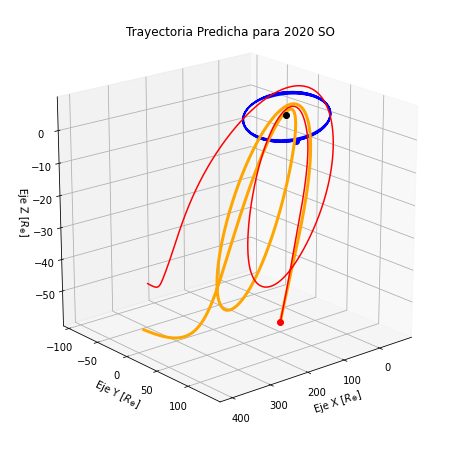

In [ ]:
from mpl_toolkits.mplot3d import Axes3D

fig = plt.figure(figsize=(8,8))
ax = fig.add_subplot(111, projection='3d')

t=0

UL = 1.5e8/6366


ax.plot(vecLuna['x']*UL,vecLuna['y']*UL,vecLuna['z']*UL,'b')
ax.plot([vecLuna['x'][t]*UL],[vecLuna['y'][t]*UL],[vecLuna['z'][t]*UL],'bo')

ax.plot(vecR2['x']*UL,vecR2['y']*UL,vecR2['z']*UL,'orange',lw=3)
ax.plot(vec['x']*UL,vec['y']*UL,vec['z']*UL,'r')
ax.plot([vec['x'][t]*UL],[vec['y'][t]*UL],[vec['z'][t]*UL],'ro')

ax.plot([0],[0],[0],'ko')

ax.set_title("Trayectoria Predicha para 2020 SO")
ax.view_init(20, 50)

plt.xlabel("Eje X [$R_{\oplus}$]")
plt.ylabel("Eje Y [$R_{\oplus}$]")
ax.set_zlabel("Eje Z [$R_{\oplus}$]")


plt.show()

# Animación

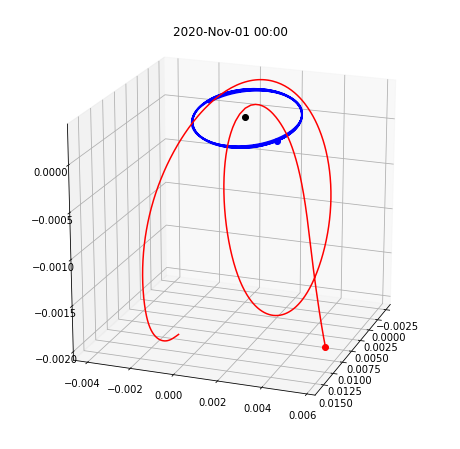

In [ ]:
import matplotlib.animation as animation
from matplotlib import rc
rc('animation', html='jshtml')

angles = np.linspace(0,-90,Nt)

k = 5

def frame(t):
  t *= k
  ax.clear()
  plot = ax.plot(vecLuna['x'],vecLuna['y'],vecLuna['z'],'b')
  ax.plot([vecLuna['x'][t]],[vecLuna['y'][t]],[vecLuna['z'][t]],'bo')
  ax.plot(vec['x'],vec['y'],vec['z'],'r')
  ax.plot([vec['x'][t]],[vec['y'][t]],[vec['z'][t]],'ro')
  ax.plot([0],[0],[0],'ko')
  ax.set_title(eph['datetime_str'][t])
  ax.view_init(20,angles[t]+20)
  return plot

fig = plt.figure(figsize=(8,8))
ax = fig.add_subplot(111, projection='3d')
anim = animation.FuncAnimation(fig, frame, frames=int(Nt/k), blit=False, repeat=True)

In [ ]:
anim

In [ ]:
Writer = animation.writers['ffmpeg']
writer = Writer(fps=5, metadata=dict(artist='Agustín-Vallejo'), bitrate=1800)
anim.save("2020_SO.mp4",writer=writer)

from google.colab import files
files.download("2020_SO.mp4")

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>